## UKBB+HCP GLM & Spatial Autocorrelation Analysis

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from env.imports import *

/ext3/miniconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
2025-04-01 09:13:08.042431: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-04-01 09:13:09.639385: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI AVX512_BF16 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-04-01 09:13:11.188804: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [3]:
from models import *
from data import * 
from env import *
from sim import *

In [4]:
# overall imports
import importlib
import data
from sim.sim_utils import bytes2human, print_system_usage

# data load
from data.data_load import load_transcriptome, load_connectome, load_coords
from data.data_viz import plot_connectome, plot_connectome_with_labels, plot_transcriptome
importlib.reload(data.data_load)
importlib.reload(data.data_viz)


<module 'data.data_viz' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/data/data_viz.py'>

In [5]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 20.7%
RAM Usage: 11.7%
Available RAM: 1.3T
Total RAM: 1.5T
52.4G


## Load in connectomes

In [6]:
Y_sc = load_connectome(parcellation='S400', omit_subcortical=False, hemisphere='both', measure='SC')
Y_fc, region_labels, lh_indices, rh_indices = load_connectome(parcellation='S400', omit_subcortical=False, hemisphere='both', measure='FC', include_labels=True)


## Load in transcriptome

Text(0.5, 0, 'Genes')

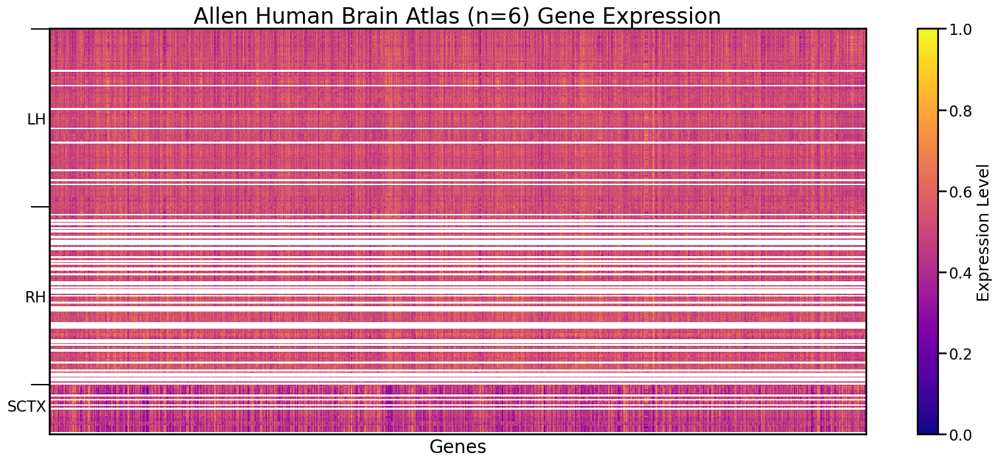

In [7]:
# Alphabetical 
X = load_transcriptome(parcellation='S400', omit_subcortical=False, hemisphere='both', sort_genes=None, impute_strategy=None)

# Visualize transcriptome matrix
plt.figure(figsize=(20, 8))
plt.imshow(X, aspect='auto', cmap='plasma')
plt.colorbar(label='Expression Level')
plt.title('Allen Human Brain Atlas (n=6) Gene Expression', fontsize=24)

# Remove default ticks
plt.gca().set_xticks([])
plt.gca().set_yticks([])

# Add region labels on y-axis
sec_ay = plt.gca().secondary_yaxis(location=0)
sec_ay.set_yticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ay.tick_params('y', length=0)

# Add lines between regions on y-axis
sec_ay_lines = plt.gca().secondary_yaxis(location=0)
sec_ay_lines.set_yticks([0, 200, 400, 456], labels=[])
sec_ay_lines.tick_params('y', length=20, width=1.5)

# Add x-axis label
plt.xlabel('Genes', fontsize=20)


Text(0.5, 0, 'Genes')

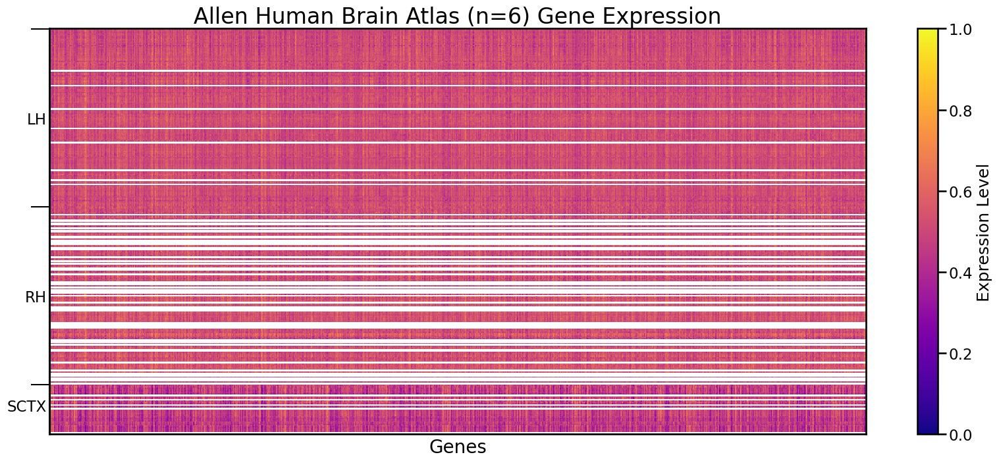

In [8]:
# Random
X = load_transcriptome(parcellation='S400', omit_subcortical=False, hemisphere='both', sort_genes='random', impute_strategy=None)

# Visualize transcriptome matrix
plt.figure(figsize=(20, 8))
plt.imshow(X, aspect='auto', cmap='plasma')
plt.colorbar(label='Expression Level')
plt.title('Allen Human Brain Atlas (n=6) Gene Expression', fontsize=24)

# Remove default ticks
plt.gca().set_xticks([])
plt.gca().set_yticks([])

# Add region labels on y-axis
sec_ay = plt.gca().secondary_yaxis(location=0)
sec_ay.set_yticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ay.tick_params('y', length=0)

# Add lines between regions on y-axis
sec_ay_lines = plt.gca().secondary_yaxis(location=0)
sec_ay_lines.set_yticks([0, 200, 400, 456], labels=[])
sec_ay_lines.tick_params('y', length=20, width=1.5)

# Add x-axis label
plt.xlabel('Genes', fontsize=20)


Text(0.5, 0, 'Genes')

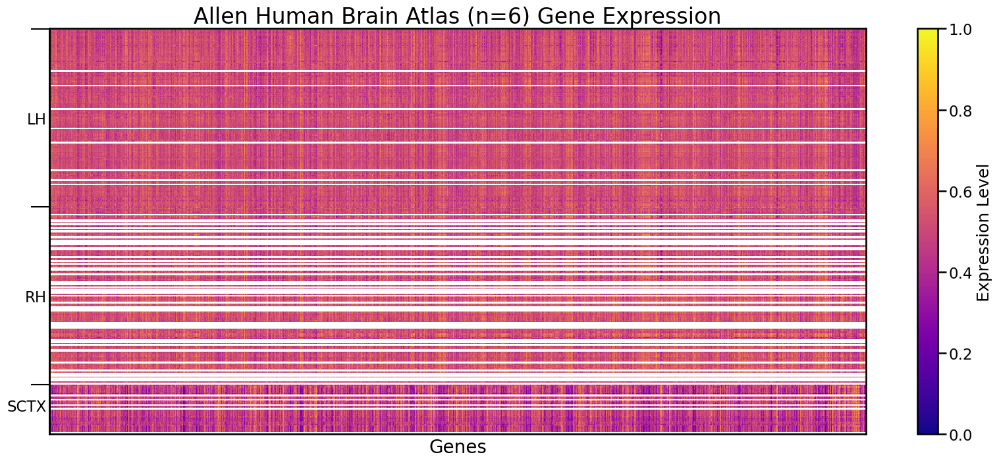

In [9]:
# Sorted by chromosome

X = load_transcriptome(parcellation='S400', omit_subcortical=False, hemisphere='both', impute_strategy=None, sort_genes='refgenome')

# Visualize transcriptome matrix
plt.figure(figsize=(20, 8))
plt.imshow(X, aspect='auto', cmap='plasma')
plt.colorbar(label='Expression Level')
plt.title('Allen Human Brain Atlas (n=6) Gene Expression', fontsize=24)

# Remove default ticks
plt.gca().set_xticks([])
plt.gca().set_yticks([])

# Add region labels on y-axis
sec_ay = plt.gca().secondary_yaxis(location=0)
sec_ay.set_yticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ay.tick_params('y', length=0)

# Add lines between regions on y-axis
sec_ay_lines = plt.gca().secondary_yaxis(location=0)
sec_ay_lines.set_yticks([0, 200, 400, 456], labels=[])
sec_ay_lines.tick_params('y', length=20, width=1.5)

# Add x-axis label
plt.xlabel('Genes', fontsize=20)


valid genes ['CRNDE', 'ECEL1', 'CHRNA3', 'RSPO4', 'TTR', 'RGS8', 'CA12', 'GINS3', 'KLHL13', 'S100PBP', 'PARD3B', 'PDE3A', 'SIX3', 'SCIN', 'NHSL1', 'BTN2A2', 'PIRT', 'RAB2B', 'SMIM30', 'DRD2', 'LONRF3', 'CYB5R3', 'SLITRK6', 'ELP4', 'HEYL', 'PKNOX1', 'GPRIN2', 'LHX8', 'MEGF11', 'C10orf105', 'AUTS2', 'PDIA3', 'PDIA3P1', 'CPNE3', 'TMEM255A', 'TMEM215', 'CYP7B1', 'IL13RA2', 'GPR75', 'TEAD1', 'KCNE5', 'PDLIM5', 'STAT1', 'C6orf118', 'CYLD', 'BAG3', 'TTPA', 'PINLYP', 'PCDH15', 'PREX2', 'PLXDC2', 'RASL12', 'DERL1', 'SCN7A', 'ARHGAP36', 'DNAJC12', 'AKIRIN2', 'ACVR1', 'ENKUR', 'NPL', 'FLVCR1', 'SAMD11', 'DNAH9', 'ADIPOR1', 'COL8A2', 'MAP3K1', 'LOC100233156', 'ADARB2-AS1', 'PFKFB3', 'SDC2', 'DAB2', 'CASC2', 'RGS22', 'PHKA1', 'HEY2', 'CENPVL3', 'PTGER3', 'CCDC85C', 'YBX3', 'PRSS35', 'VANGL1', 'PLXNA3', 'GLUD1', 'SSR1', 'MLF1', 'FAM210B', 'SERPINB1', 'WDR1', 'CFLAR', 'SZRD1', 'DAPL1', 'SPATA18', 'STK33', 'CFAP61', 'MAML2', 'DIRC2', 'ZNF516', 'MINK1', 'FAM111A', 'LINC01485', 'SCN9A', 'LINC00886', 'CX

Text(0.5, 0, 'Genes')

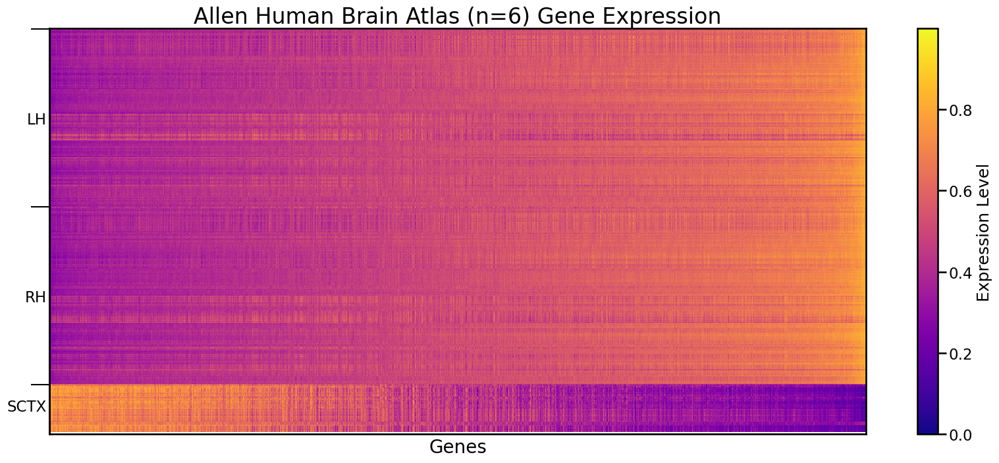

In [10]:
# Imputeed and sorted by mean expression
X, valid_genes = load_transcriptome(parcellation='S400', omit_subcortical=False, hemisphere='both', sort_genes='expression', impute_strategy='mirror_interpolate', return_valid_genes=True)

# Visualize transcriptome matrix
plt.figure(figsize=(20, 8))
plt.imshow(X, aspect='auto', cmap='plasma')
plt.colorbar(label='Expression Level')
plt.title('Allen Human Brain Atlas (n=6) Gene Expression', fontsize=24)

# Remove default ticks
plt.gca().set_xticks([])
plt.gca().set_yticks([])

# Add region labels on y-axis
sec_ay = plt.gca().secondary_yaxis(location=0)
sec_ay.set_yticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ay.tick_params('y', length=0)

# Add lines between regions on y-axis
sec_ay_lines = plt.gca().secondary_yaxis(location=0)
sec_ay_lines.set_yticks([0, 200, 400, 456], labels=[])
sec_ay_lines.tick_params('y', length=20, width=1.5)

# Add x-axis label
plt.xlabel('Genes', fontsize=20)

Text(0.5, 0, 'Genes')

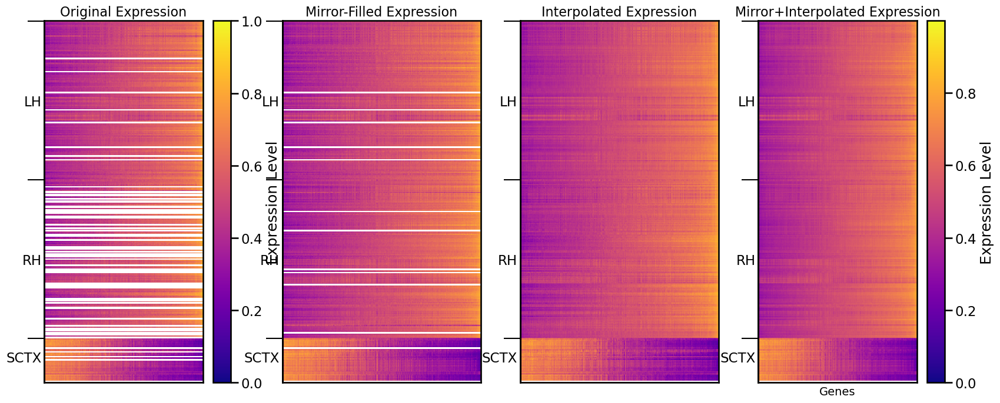

In [13]:

# Load different versions of transcriptome data for reference
X = load_transcriptome(parcellation='S400', omit_subcortical=False, hemisphere='both', sort_genes='expression', impute_strategy=None)
X_mirror = load_transcriptome(parcellation='S400', omit_subcortical=False, hemisphere='both', sort_genes='expression', impute_strategy='mirror')
X_interpolate = load_transcriptome(parcellation='S400', omit_subcortical=False, hemisphere='both', sort_genes='expression', impute_strategy='interpolate')
X_mirror_interpolate = load_transcriptome(parcellation='S400', omit_subcortical=False, hemisphere='both', sort_genes='expression', impute_strategy='mirror_interpolate')

# Visualize all versions
plt.figure(figsize=(20, 8))

plt.subplot(141)
plt.imshow(X, aspect='auto', cmap='plasma')
plt.colorbar(label='Expression Level')
plt.title('Original Expression', fontsize=16)

# Remove default ticks
plt.gca().set_xticks([])
plt.gca().set_yticks([])

# Add region labels on y-axis
sec_ay = plt.gca().secondary_yaxis(location=0)
sec_ay.set_yticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ay.tick_params('y', length=0)

# Add lines between regions on y-axis
sec_ay_lines = plt.gca().secondary_yaxis(location=0)
sec_ay_lines.set_yticks([0, 200, 400, 456], labels=[])
sec_ay_lines.tick_params('y', length=20, width=1.5)

plt.subplot(142)
plt.imshow(X_mirror, aspect='auto', cmap='plasma')
plt.title('Mirror-Filled Expression', fontsize=16)

# Remove default ticks
plt.gca().set_xticks([])
plt.gca().set_yticks([])

# Add region labels on y-axis
sec_ay = plt.gca().secondary_yaxis(location=0)
sec_ay.set_yticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ay.tick_params('y', length=0)

# Add lines between regions on y-axis
sec_ay_lines = plt.gca().secondary_yaxis(location=0)
sec_ay_lines.set_yticks([0, 200, 400, 456], labels=[])
sec_ay_lines.tick_params('y', length=20, width=1.5)

plt.subplot(143)
plt.imshow(X_interpolate, aspect='auto', cmap='plasma')
plt.title('Interpolated Expression', fontsize=16)

# Remove default ticks
plt.gca().set_xticks([])
plt.gca().set_yticks([])

# Add region labels on y-axis
sec_ay = plt.gca().secondary_yaxis(location=0)
sec_ay.set_yticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ay.tick_params('y', length=0)

# Add lines between regions on y-axis
sec_ay_lines = plt.gca().secondary_yaxis(location=0)
sec_ay_lines.set_yticks([0, 200, 400, 456], labels=[])
sec_ay_lines.tick_params('y', length=20, width=1.5)

plt.subplot(144)
plt.imshow(X_mirror_interpolate, aspect='auto', cmap='plasma')
plt.colorbar(label='Expression Level')
plt.title('Mirror+Interpolated Expression', fontsize=16)

# Remove default ticks
plt.gca().set_xticks([])
plt.gca().set_yticks([])

# Add region labels on y-axis
sec_ay = plt.gca().secondary_yaxis(location=0)
sec_ay.set_yticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ay.tick_params('y', length=0)

# Add lines between regions on y-axis
sec_ay_lines = plt.gca().secondary_yaxis(location=0)
sec_ay_lines.set_yticks([0, 200, 400, 456], labels=[])
sec_ay_lines.tick_params('y', length=20, width=1.5)

# Add x-axis label
plt.xlabel('Genes', fontsize=14)


In [14]:
# Set paths
GeneEx2Conn_path = os.path.normpath(os.getcwd())
UKBB_path = os.path.normpath(os.getcwd() + os.sep + os.pardir) + '/GeneEx2Conn_data/Penn_UKBB_data/'
print(GeneEx2Conn_path)
print(UKBB_path)

UKBB_demographics = pd.read_csv(UKBB_path + '/metadata/UKBB_MasterList_DemogInfo_part.csv')
unique_subject_ids = list(set([x.split('-')[1] for x in os.listdir(UKBB_path + '/XCP_D/') if x.startswith('sub-')]))

schaef156_atlas_path = UKBB_path + '/atlases/atlas-4S156Parcels/atlas-4S156Parcels_dseg.tsv'
schaef156_atlas_info = pd.read_csv(schaef156_atlas_path, sep='\t')
schaef156_labels = schaef156_atlas_info['label'].tolist()

schaef456_atlas_path = UKBB_path + '/atlases/atlas-4S456Parcels/atlas-4S456Parcels_dseg.tsv'
schaef456_atlas_info = pd.read_csv(schaef456_atlas_path, sep='\t')
schaef456_labels = schaef456_atlas_info['label'].tolist()

schaef156_atlas_info.loc[schaef156_atlas_info['atlas_name'] == 'Cerebellum', 'network_label'] = 'Cerebellum'
schaef156_atlas_info.loc[(schaef156_atlas_info['network_label'].isna()) & 
                        (schaef156_atlas_info['atlas_name'] != 'Cerebellum'), 'network_label'] = 'Subcortical'

schaef456_atlas_info.loc[schaef456_atlas_info['atlas_name'] == 'Cerebellum', 'network_label'] = 'Cerebellum'
schaef456_atlas_info.loc[(schaef456_atlas_info['network_label'].isna()) & 
                        (schaef456_atlas_info['atlas_name'] != 'Cerebellum'), 'network_label'] = 'Subcortical'

schaef156_labels = schaef156_atlas_info['label'].tolist()
schaef156_network_labels = schaef156_atlas_info['network_label'].values
schaef456_labels = schaef456_atlas_info['label'].tolist()
schaef456_network_labels = schaef456_atlas_info['network_label'].values

/scratch/asr655/neuroinformatics/GeneEx2Conn
/scratch/asr655/neuroinformatics/GeneEx2Conn_data/Penn_UKBB_data/


Text(0.5, 0, 'Genes')

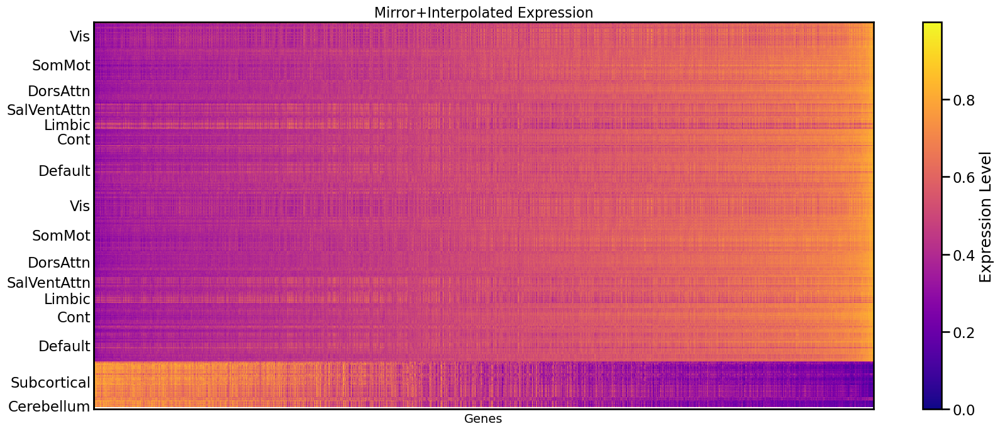

In [16]:
# Get unique network labels and their positions
unique_networks = []
network_positions = []
prev_network = schaef456_network_labels[0]
start_pos = 0

for i, network in enumerate(schaef456_network_labels):
    if network != prev_network:
        unique_networks.append(prev_network)
        network_positions.append((start_pos + i - 1) / 2)
        start_pos = i
        prev_network = network

# Add final network
unique_networks.append(prev_network)
network_positions.append((start_pos + len(schaef456_network_labels) - 1) / 2)


plt.figure(figsize=(20, 8))

plt.imshow(X_mirror_interpolate, aspect='auto', cmap='plasma')
plt.colorbar(label='Expression Level')
plt.title('Mirror+Interpolated Expression', fontsize=16)

# Remove default ticks
plt.gca().set_xticks([])
plt.gca().set_yticks([])

# Add network labels on y-axis
sec_ay = plt.gca().secondary_yaxis(location=0)
sec_ay.set_yticks(network_positions, labels=unique_networks)
sec_ay.tick_params('y', length=0)

# Add x-axis label
plt.xlabel('Genes', fontsize=14)

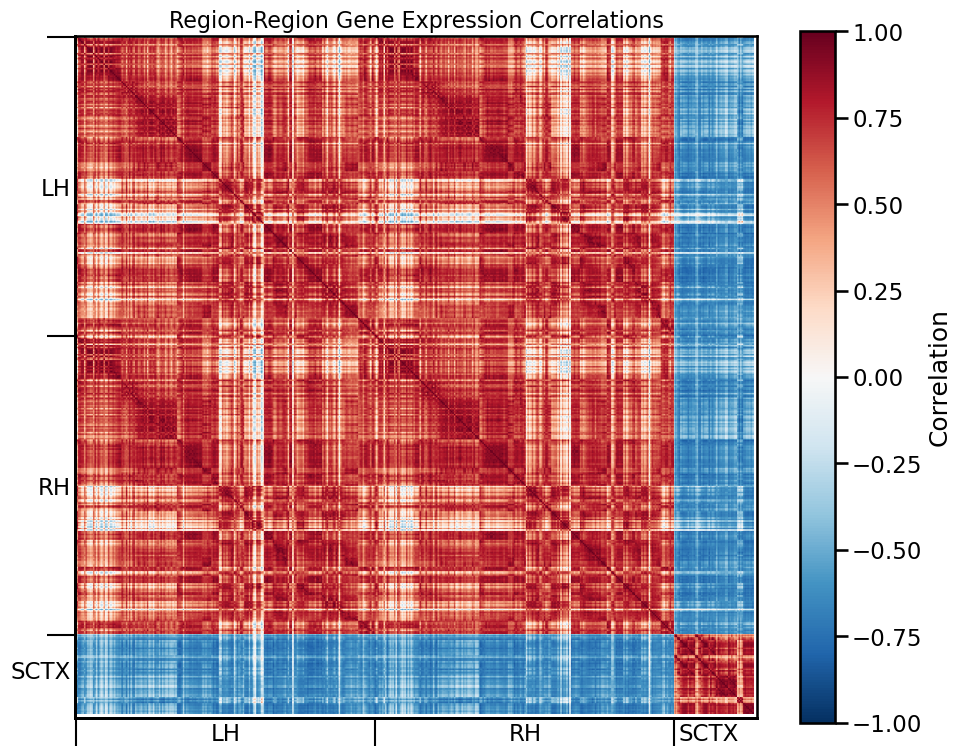

In [20]:
# Calculate correlation matrix of gene expression between regions
gene_expr_corr = np.corrcoef(X_mirror_interpolate)

# Create correlation matrix visualization
plt.figure(figsize=(10, 8))
im = plt.imshow(gene_expr_corr, cmap='RdBu_r', vmin=-1, vmax=1)
plt.colorbar(label='Correlation')
plt.title('Region-Region Gene Expression Correlations', fontsize=16)

# Remove default ticks
plt.gca().set_xticks([])
plt.gca().set_yticks([])

# Add hemisphere labels and lines on both axes
sec_ax = plt.gca().secondary_xaxis(location=0)
sec_ax.set_xticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ax.tick_params('x', length=0)

# Add lines between regions - x-axis
sec_ax_lines = plt.gca().secondary_xaxis(location=0)
sec_ax_lines.set_xticks([0, 200, 400, 456], labels=[])
sec_ax_lines.tick_params('x', length=20, width=1.5)

# Add hemisphere labels and lines on y-axis
sec_ay = plt.gca().secondary_yaxis(location=0)
sec_ay.set_yticks([100, 300, 423], labels=['LH', 'RH', 'SCTX']) 
sec_ay.tick_params('y', length=0)

# Add lines between regions - y-axis
sec_ay_lines = plt.gca().secondary_yaxis(location=0)
sec_ay_lines.set_yticks([0, 200, 400, 456], labels=[])
sec_ay_lines.tick_params('y', length=20, width=1.5)

plt.tight_layout()


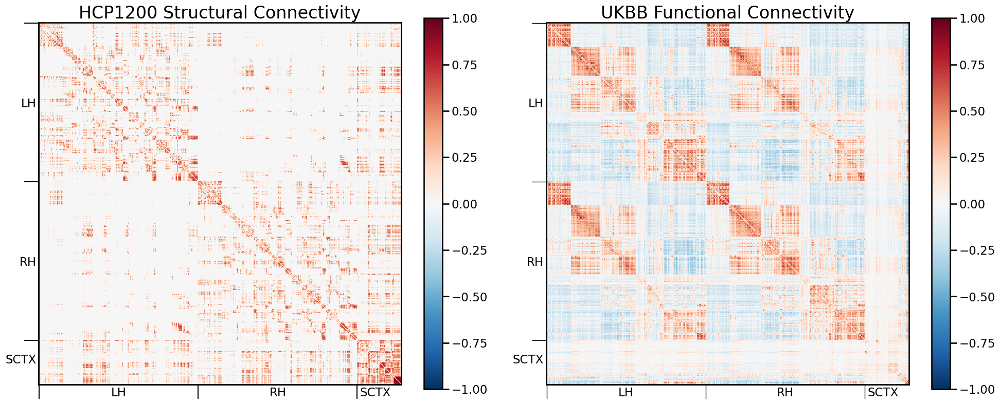

In [21]:
# Visualize structural and functional connectivity matrices
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))

# Plot structural connectivity
im1 = ax1.imshow(Y_sc, cmap='RdBu_r', vmin=-1, vmax=1)
ax1.set_title('HCP1200 Structural Connectivity', fontsize=24)
plt.colorbar(im1, ax=ax1)

# Remove main ticks
ax1.set_xticks([])
ax1.set_yticks([])
# Secondary axis for region labels - structural
sec_ax1 = ax1.secondary_xaxis(location=0)
sec_ax1.set_xticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ax1.tick_params('x', length=0)

# Add lines between regions - structural x-axis
sec_ax1_lines = ax1.secondary_xaxis(location=0)
sec_ax1_lines.set_xticks([0, 200, 400, 456], labels=[])
sec_ax1_lines.tick_params('x', length=20, width=1.5)

# Secondary axis for region labels - structural y-axis
sec_ay1 = ax1.secondary_yaxis(location=0)
sec_ay1.set_yticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ay1.tick_params('y', length=0)

# Add lines between regions - structural y-axis
sec_ay1_lines = ax1.secondary_yaxis(location=0)
sec_ay1_lines.set_yticks([0, 200, 400, 456], labels=[])
sec_ay1_lines.tick_params('y', length=20, width=1.5)

# Plot functional connectivity
im2 = ax2.imshow(Y_fc, cmap='RdBu_r', vmin=-1, vmax=1)
ax2.set_title('UKBB Functional Connectivity', fontsize=24)
plt.colorbar(im2, ax=ax2)

# Remove main ticks
ax2.set_xticks([])
ax2.set_yticks([])

# Secondary axis for region labels - functional x-axis
sec_ax2 = ax2.secondary_xaxis(location=0)
sec_ax2.set_xticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ax2.tick_params('x', length=0)

# Add lines between regions - functional x-axis
sec_ax2_lines = ax2.secondary_xaxis(location=0)
sec_ax2_lines.set_xticks([0, 200, 400, 456], labels=[])
sec_ax2_lines.tick_params('x', length=20, width=1)

# Secondary axis for region labels - functional y-axis
sec_ay2 = ax2.secondary_yaxis(location=0)
sec_ay2.set_yticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ay2.tick_params('y', length=0)

# Add lines between regions - functional y-axis
sec_ay2_lines = ax2.secondary_yaxis(location=0)
sec_ay2_lines.set_yticks([0, 200, 400, 456], labels=[])
sec_ay2_lines.tick_params('y', length=20, width=1)

plt.tight_layout()
plt.show()


### S456 transcriptome and connectomes

#### Construct the features for the GLM 

All edges

In [22]:
Y_sc = load_connectome(parcellation='S400', omit_subcortical=False, hemisphere='both', measure='SC')
Y_fc, region_labels, lh_indices, rh_indices = load_connectome(parcellation='S400', omit_subcortical=False, hemisphere='both', measure='FC', include_labels=True)
X_mirror_interpolate = load_transcriptome(parcellation='S400', omit_subcortical=False, hemisphere='both', sort_genes='expression', impute_strategy='mirror_interpolate')

UKBB_S456_atlas_info_path = os.path.normpath(os.getcwd() + os.sep + os.pardir) + '/GeneEx2Conn_data/atlas_info/atlas-4S456Parcels_dseg_reformatted.csv'
UKBB_S456_atlas_info = pd.read_csv(UKBB_S456_atlas_info_path)

# Store labels and network labels from atlas info
region_labels = UKBB_S456_atlas_info['label'].tolist()
network_labels = UKBB_S456_atlas_info['network_label'].tolist()

# Update network labels for Cerebellum and Subcortical regions
UKBB_S456_atlas_info.loc[UKBB_S456_atlas_info['atlas_name'] == 'Cerebellum', 'network_label'] = 'Cerebellum'
UKBB_S456_atlas_info.loc[(UKBB_S456_atlas_info['network_label'].isna()) & 
                        (UKBB_S456_atlas_info['atlas_name'] != 'Cerebellum'), 'network_label'] = 'Subcortical'

# Update network_labels list after modifications
network_labels = UKBB_S456_atlas_info['network_label'].tolist()

network_labels = schaef456_network_labels

# Store MNI coordinates from atlas info as list of [x,y,z] coordinates
mni_coords = [[x, y, z] for x, y, z in zip(UKBB_S456_atlas_info['mni_x'], 
                                          UKBB_S456_atlas_info['mni_y'],
                                          UKBB_S456_atlas_info['mni_z'])]


In [24]:
X = X_mirror_interpolate
Y_sc = Y_sc
Y_fc = Y_fc
network_labels = np.array(network_labels)
region_labels = np.array(region_labels)
mni_coords = np.array(mni_coords)
print("Before filtering:")
print("X shape:", X.shape)
print("Y_sc shape:", Y_sc.shape)
print("Y_fc shape:", Y_fc.shape)
print("Network labels shape:", network_labels.shape)
print("Region labels shape:", region_labels.shape)
print("MNI coordinates shape:", mni_coords.shape)
print()

# Create mask for non-NaN values
mask = ~np.isnan(X).any(axis=1) & ~np.isnan(Y_fc).any(axis=1)

# Apply mask to all arrays
X = X[mask]
Y_sc = Y_sc[mask][:, mask]
Y_fc = Y_fc[mask][:, mask]
network_labels = network_labels[mask]
region_labels = region_labels[mask]
mni_coords = mni_coords[mask]

print("After filtering:")
print("X shape:", X.shape)
print("Y_sc shape:", Y_sc.shape) 
print("Y_fc shape:", Y_fc.shape)
print("Network labels shape:", network_labels.shape)
print("Region labels shape:", region_labels.shape)
print("MNI coordinates shape:", mni_coords.shape)
print()


Before filtering:
X shape: (456, 7380)
Y_sc shape: (456, 456)
Y_fc shape: (456, 456)
Network labels shape: (456,)
Region labels shape: (456,)
MNI coordinates shape: (456, 3)

After filtering:
X shape: (455, 7380)
Y_sc shape: (455, 455)
Y_fc shape: (455, 455)
Network labels shape: (455,)
Region labels shape: (455,)
MNI coordinates shape: (455, 3)



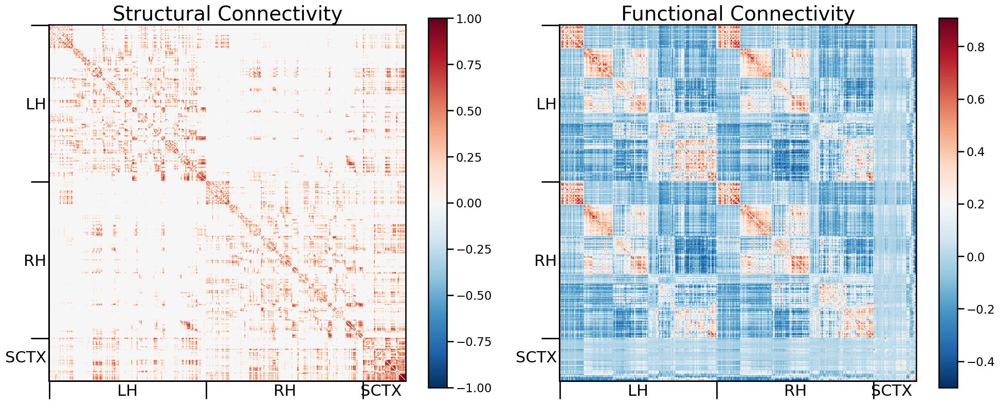

In [47]:
# Visualize structural and functional connectivity matrices
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))

font_size = 22
title_size = 28

im1 = ax1.imshow(Y_sc, cmap='RdBu_r', vmin=-1, vmax=1)
ax1.set_title('Structural Connectivity', fontsize=title_size)
plt.colorbar(im1, ax=ax1)

# Remove numbered ticks
ax1.set_xticks([])
ax1.set_yticks([])

# Secondary axis for region labels - structural x-axis
sec_ax1 = ax1.secondary_xaxis(location=0)
sec_ax1.set_xticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ax1.tick_params('x', length=0, labelsize=font_size)

# Add lines between regions - structural x-axis
sec_ax1_lines = ax1.secondary_xaxis(location=0)
sec_ax1_lines.set_xticks([0, 200, 400, 456], labels=[])
sec_ax1_lines.tick_params('x', length=25, width=2)

# Secondary axis for region labels - structural y-axis
sec_ay1 = ax1.secondary_yaxis(location=0)
sec_ay1.set_yticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ay1.tick_params('y', length=0, labelsize=font_size)

# Add lines between regions - structural y-axis
sec_ay1_lines = ax1.secondary_yaxis(location=0)
sec_ay1_lines.set_yticks([0, 200, 400, 456], labels=[])
sec_ay1_lines.tick_params('y', length=25, width=2)

im2 = ax2.imshow(Y_fc, cmap='RdBu_r')
ax2.set_title('Functional Connectivity', fontsize=title_size) 
plt.colorbar(im2, ax=ax2)

# Remove numbered ticks
ax2.set_xticks([])
ax2.set_yticks([])

# Secondary axis for region labels - functional x-axis
sec_ax2 = ax2.secondary_xaxis(location=0)
sec_ax2.set_xticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ax2.tick_params('x', length=0, labelsize=font_size)

# Add lines between regions - functional x-axis
sec_ax2_lines = ax2.secondary_xaxis(location=0)
sec_ax2_lines.set_xticks([0, 200, 400, 456], labels=[])
sec_ax2_lines.tick_params('x', length=25, width=2)

# Secondary axis for region labels - functional y-axis
sec_ay2 = ax2.secondary_yaxis(location=0)
sec_ay2.set_yticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ay2.tick_params('y', length=0, labelsize=font_size)

# Add lines between regions - functional y-axis
sec_ay2_lines = ax2.secondary_yaxis(location=0)
sec_ay2_lines.set_yticks([0, 200, 400, 456], labels=[])
sec_ay2_lines.tick_params('y', length=25, width=2)

plt.tight_layout()
plt.show()


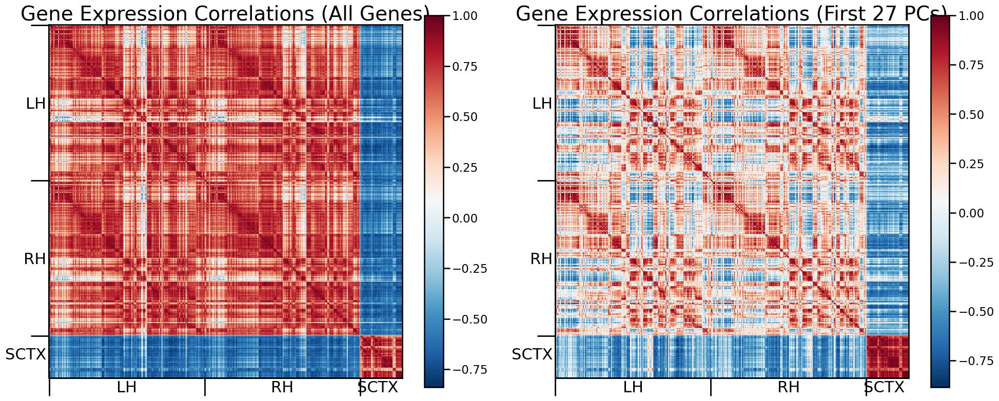

In [48]:
# Calculate gene expression correlations between regions
gene_corr = np.corrcoef(X)

# Calculate PCA of gene expression
pca = PCA()
X_pca = pca.fit_transform(X)

# Find number of components for 95% variance
cumulative_variance = np.cumsum(pca.explained_variance_ratio_)
n_components = np.argmax(cumulative_variance >= 0.95) + 1
X_pca_95 = X_pca[:, :n_components]

# Calculate correlations using PCA-reduced gene expression
gene_corr_pca = np.corrcoef(X_pca_95)

# Visualize gene expression correlations with PCA
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))

im1 = ax1.imshow(gene_corr, cmap='RdBu_r')
ax1.set_title('Gene Expression Correlations (All Genes)', fontsize=title_size)
plt.colorbar(im1, ax=ax1)

# Remove numbered ticks for first plot
ax1.set_xticks([])
ax1.set_yticks([])

# Secondary axis for region labels - first plot x-axis
sec_ax1 = ax1.secondary_xaxis(location=0)
sec_ax1.set_xticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ax1.tick_params('x', length=0, labelsize=font_size)

# Add lines between regions - first plot x-axis
sec_ax1_lines = ax1.secondary_xaxis(location=0)
sec_ax1_lines.set_xticks([0, 200, 400, 456], labels=[])
sec_ax1_lines.tick_params('x', length=25, width=2)

# Secondary axis for region labels - first plot y-axis
sec_ay1 = ax1.secondary_yaxis(location=0)
sec_ay1.set_yticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ay1.tick_params('y', length=0, labelsize=font_size)

# Add lines between regions - first plot y-axis
sec_ay1_lines = ax1.secondary_yaxis(location=0)
sec_ay1_lines.set_yticks([0, 200, 400, 456], labels=[])
sec_ay1_lines.tick_params('y', length=25, width=2)

im2 = ax2.imshow(gene_corr_pca, cmap='RdBu_r')
ax2.set_title(f'Gene Expression Correlations (First {n_components} PCs)', fontsize=title_size)
plt.colorbar(im2, ax=ax2)

# Remove numbered ticks for second plot
ax2.set_xticks([])
ax2.set_yticks([])

# Secondary axis for region labels - second plot x-axis
sec_ax2 = ax2.secondary_xaxis(location=0)
sec_ax2.set_xticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ax2.tick_params('x', length=0, labelsize=font_size)

# Add lines between regions - second plot x-axis
sec_ax2_lines = ax2.secondary_xaxis(location=0)
sec_ax2_lines.set_xticks([0, 200, 400, 456], labels=[])
sec_ax2_lines.tick_params('x', length=25, width=2)

# Secondary axis for region labels - second plot y-axis
sec_ay2 = ax2.secondary_yaxis(location=0)
sec_ay2.set_yticks([100, 300, 423], labels=['LH', 'RH', 'SCTX'])
sec_ay2.tick_params('y', length=0, labelsize=font_size)

# Add lines between regions - second plot y-axis
sec_ay2_lines = ax2.secondary_yaxis(location=0)
sec_ay2_lines.set_yticks([0, 200, 400, 456], labels=[])
sec_ay2_lines.tick_params('y', length=25, width=2)

plt.tight_layout()
plt.show()


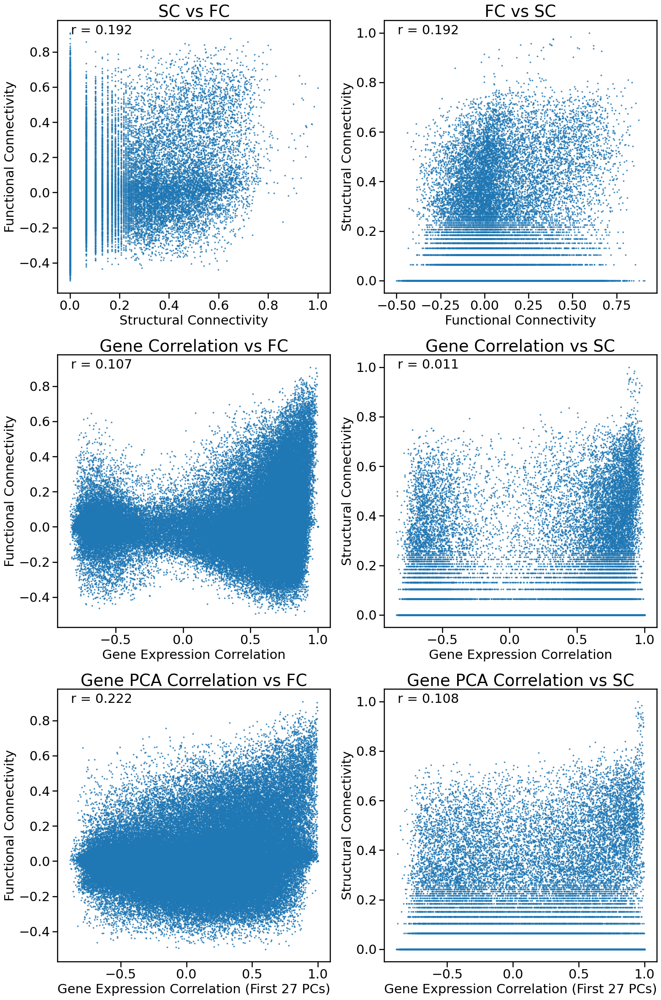

In [49]:
# Create figure with 3 rows of plots
fig, axes = plt.subplots(3, 2, figsize=(16, 24))

# Flatten axes for easier iteration
axes = axes.flatten()

# Plot settings
scatter_size = 1.5

# Row 1: SC vs FC and FC vs SC
corr_sc_fc = np.corrcoef(Y_sc.flatten(), Y_fc.flatten())[0,1]
axes[0].scatter(Y_sc.flatten(), Y_fc.flatten(), s=scatter_size, alpha=0.5)
axes[0].set_xlabel('Structural Connectivity', fontsize=font_size)
axes[0].set_ylabel('Functional Connectivity', fontsize=font_size)
axes[0].set_title('SC vs FC', fontsize=title_size)
axes[0].text(0.05, 0.95, f'r = {corr_sc_fc:.3f}', transform=axes[0].transAxes, fontsize=font_size)
axes[0].tick_params(labelsize=font_size)

corr_fc_sc = np.corrcoef(Y_fc.flatten(), Y_sc.flatten())[0,1]
axes[1].scatter(Y_fc.flatten(), Y_sc.flatten(), s=scatter_size, alpha=0.5)
axes[1].set_xlabel('Functional Connectivity', fontsize=font_size)
axes[1].set_ylabel('Structural Connectivity', fontsize=font_size) 
axes[1].set_title('FC vs SC', fontsize=title_size)
axes[1].text(0.05, 0.95, f'r = {corr_fc_sc:.3f}', transform=axes[1].transAxes, fontsize=font_size)
axes[1].tick_params(labelsize=font_size)

# Row 2: Gene correlation vs FC and SC
corr_gene_fc = np.corrcoef(gene_corr.flatten(), Y_fc.flatten())[0,1]
axes[2].scatter(gene_corr.flatten(), Y_fc.flatten(), s=scatter_size, alpha=0.5)
axes[2].set_xlabel('Gene Expression Correlation', fontsize=font_size)
axes[2].set_ylabel('Functional Connectivity', fontsize=font_size)
axes[2].set_title('Gene Correlation vs FC', fontsize=title_size)
axes[2].text(0.05, 0.95, f'r = {corr_gene_fc:.3f}', transform=axes[2].transAxes, fontsize=font_size)
axes[2].tick_params(labelsize=font_size)

corr_gene_sc = np.corrcoef(gene_corr.flatten(), Y_sc.flatten())[0,1]
axes[3].scatter(gene_corr.flatten(), Y_sc.flatten(), s=scatter_size, alpha=0.5)
axes[3].set_xlabel('Gene Expression Correlation', fontsize=font_size)
axes[3].set_ylabel('Structural Connectivity', fontsize=font_size)
axes[3].set_title('Gene Correlation vs SC', fontsize=title_size)
axes[3].text(0.05, 0.95, f'r = {corr_gene_sc:.3f}', transform=axes[3].transAxes, fontsize=font_size)
axes[3].tick_params(labelsize=font_size)

# Row 3: Gene PCA correlation vs FC and SC
corr_pca_fc = np.corrcoef(gene_corr_pca.flatten(), Y_fc.flatten())[0,1]
axes[4].scatter(gene_corr_pca.flatten(), Y_fc.flatten(), s=scatter_size, alpha=0.5)
axes[4].set_xlabel(f'Gene Expression Correlation (First {n_components} PCs)', fontsize=font_size)
axes[4].set_ylabel('Functional Connectivity', fontsize=font_size)
axes[4].set_title('Gene PCA Correlation vs FC', fontsize=title_size)
axes[4].text(0.05, 0.95, f'r = {corr_pca_fc:.3f}', transform=axes[4].transAxes, fontsize=font_size)
axes[4].tick_params(labelsize=font_size)

corr_pca_sc = np.corrcoef(gene_corr_pca.flatten(), Y_sc.flatten())[0,1]
axes[5].scatter(gene_corr_pca.flatten(), Y_sc.flatten(), s=scatter_size, alpha=0.5)
axes[5].set_xlabel(f'Gene Expression Correlation (First {n_components} PCs)', fontsize=font_size)
axes[5].set_ylabel('Structural Connectivity', fontsize=font_size)
axes[5].set_title('Gene PCA Correlation vs SC', fontsize=title_size)
axes[5].text(0.05, 0.95, f'r = {corr_pca_sc:.3f}', transform=axes[5].transAxes, fontsize=font_size)
axes[5].tick_params(labelsize=font_size)

# Adjust layout
plt.tight_layout()
plt.show()

Edge-wise dataset creation function

In [56]:
def construct_features_masked(X, Y_sc, Y_fc, mni_coords, mask_from, mask_to, network_labels=None):
    """
    Construct features for GLM modeling from input data matrices using masks to specify regions.
    
    Args:
        X: Full gene expression data matrix (AHBA_cortical_transcriptome)
        Y_sc: Full structural connectivity matrix
        Y_fc: Full functional connectivity matrix  
        mni_coords: MNI coordinates for all regions
        mask_from: Boolean mask for source regions (e.g. cortical_mask, left_hemi_mask)
        mask_to: Boolean mask for target regions (e.g. cortical_mask, right_hemi_mask)
        network_labels: Optional list of network labels for each region
        
    Returns:
        Dictionary containing feature arrays and embeddings for the masked subset
    """
    mni_coords_from = mni_coords[mask_from]
    mni_coords_to = mni_coords[mask_to]
    
    # Get masked connectivity matrices
    Y_sc_masked = Y_sc[mask_from][:, mask_to]
    Y_fc_masked = Y_fc[mask_from][:, mask_to]

    # Compute PCA from all gene expression data - determine components for 95% variance
    pca = PCA()
    X_pca_full = pca.fit_transform(X)
    cumulative_variance = np.cumsum(pca.explained_variance_ratio_)
    n_components = np.argmax(cumulative_variance >= 0.95) + 1
    X_pca_full = X_pca_full[:, :n_components]
    print(f"PCA matrix shape after subsetting: {X_pca_full.shape}")
    
    # Get masked PCA components
    X_pca_masked_from = X_pca_full[mask_from]
    X_pca_masked_to = X_pca_full[mask_to]
    
    # Get masked gene expression
    X_masked_from = X[mask_from]
    X_masked_to = X[mask_to]

    # Get masked network labels if provided
    if network_labels is not None:
        network_labels_from = network_labels[mask_from]
        network_labels_to = network_labels[mask_to]

    # Calculate features between all pairs of masked regions
    num_from = len(mni_coords_from)
    num_to = len(mni_coords_to)
    
    distances = []
    sc_values = []
    fc_values = [] 
    gene_coexpression = []
    gene_PCA_coexpression = []
    edge_PCA_embeddings = []
    edge_mni_coords = []
    edge_networks = [] if network_labels is not None else None

    for i in range(num_from):
        for j in range(num_to):
            # Skip self-connections if masks overlap
            if mask_from is mask_to and i > j:
                continue
            
            if i < j:
                # Calculate euclidean distance between regions i and j
                dist = np.sqrt(np.sum((mni_coords_from[i] - mni_coords_to[j])**2))
                distances.append(dist)
                
                # Get connectivity values between regions i and j
                sc_values.append(Y_sc_masked[i, j])
                fc_values.append(Y_fc_masked[i, j])
                
                # Calculate gene expression similarity
                gene_coexp = np.corrcoef(X_masked_from[i], X_masked_to[j])[0,1]
                gene_coexpression.append(gene_coexp)
                
                # Calculate PCA-based gene expression similarity
                gene_pca_coexp = np.corrcoef(X_pca_masked_from[i], X_pca_masked_to[j])[0,1]
                gene_PCA_coexpression.append(gene_pca_coexp)
                
                # Store embeddings
                edge_PCA_embeddings.append(np.concatenate([X_pca_masked_from[i], X_pca_masked_to[j]]))
                edge_mni_coords.append(np.concatenate([mni_coords_from[i], mni_coords_to[j]]))

                # Store network pairs if labels provided
                if network_labels is not None:
                    edge_networks.append((network_labels_from[i], network_labels_to[j]))

    # Convert lists to arrays
    features = {
        'distances': np.array(distances),
        'sc_values': np.array(sc_values),
        'fc_values': np.array(fc_values),
        'gene_coexpression': np.array(gene_coexpression),
        'gene_PCA_coexpression': np.array(gene_PCA_coexpression),
        'edge_PCA_embeddings': np.array(edge_PCA_embeddings),
        'edge_mni_coords': np.array(edge_mni_coords)
    }

    if edge_networks is not None:
        features['edge_networks'] = edge_networks
    
    return features

In [57]:
# Call the function with our datasets
features = construct_features_masked(
    X=X,
    Y_sc=Y_sc, 
    Y_fc=Y_fc,
    mni_coords=mni_coords,
    mask_from=np.ones(X.shape[0], dtype=bool),
    mask_to=np.ones(X.shape[0], dtype=bool), 
    network_labels=network_labels
)

print("Distances shape:", features['distances'].shape)
print("SC values shape:", features['sc_values'].shape)
print("FC values shape:", features['fc_values'].shape)
print("Gene coexpression shape:", features['gene_coexpression'].shape)
print("Gene PCA coexpression shape:", features['gene_PCA_coexpression'].shape)
print("Gene PCA shape:", features['edge_PCA_embeddings'].shape)
print("MNI coordinates shape:", features['edge_mni_coords'].shape)
print("Network pairs shape:", len(features['edge_networks']))


PCA matrix shape after subsetting: (455, 27)


Distances shape: (103285,)
SC values shape: (103285,)
FC values shape: (103285,)
Gene coexpression shape: (103285,)
Gene PCA coexpression shape: (103285,)
Gene PCA shape: (103285, 54)
MNI coordinates shape: (103285, 6)
Network pairs shape: 103285


In [59]:
def analyze_feature_correlations(features, feature_names=None, labels=None):
    """
    Analyze correlations between features and check for NaN values.
    
    Parameters:
    features (dict): Dictionary containing feature arrays
    feature_names (list): List of feature names to analyze. If None, uses default list.
    labels (list): List of labels for plotting. If None, uses default list.
    """
    if feature_names is None:
        feature_names = ['distances', 'sc_values', 'fc_values', 'gene_coexpression', 
                        'gene_PCA_coexpression', 'spectral_similarity']
    if labels is None:
        labels = ['Distance', 'SC', 'FC', 'Gene Coexp', 'Gene PCA', 'Spectral']
        
    # Check for NaNs in each feature
    for name in feature_names:
        nan_mask = np.isnan(features[name])
        if np.any(nan_mask):
            print(f"NaNs detected in {name} at indices: {np.where(nan_mask)}")

    # Compute correlations between all pairs of features
    n = len(feature_names)
    correlations = np.zeros((n, n))

    for i in range(n):
        for j in range(n):
            correlations[i,j] = np.corrcoef(features[feature_names[i]], 
                                          features[feature_names[j]])[0,1]

    # Create heatmap
    plt.figure(figsize=(10,8))
    sns.heatmap(correlations,
                xticklabels=labels,
                yticklabels=labels, 
                annot=True,
                fmt='.3f',
                cmap='RdBu_r',
                center=0,
                vmin=-1,
                vmax=1,
                square=True)
    plt.title('Correlation heatmap')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

    # Print individual correlations for reference
    print("\nDetailed correlations:")
    for i in range(n):
        for j in range(i+1,n):
            print(f"Correlation between {labels[i]} and {labels[j]}: {correlations[i,j]:.3f}")
    
    return correlations

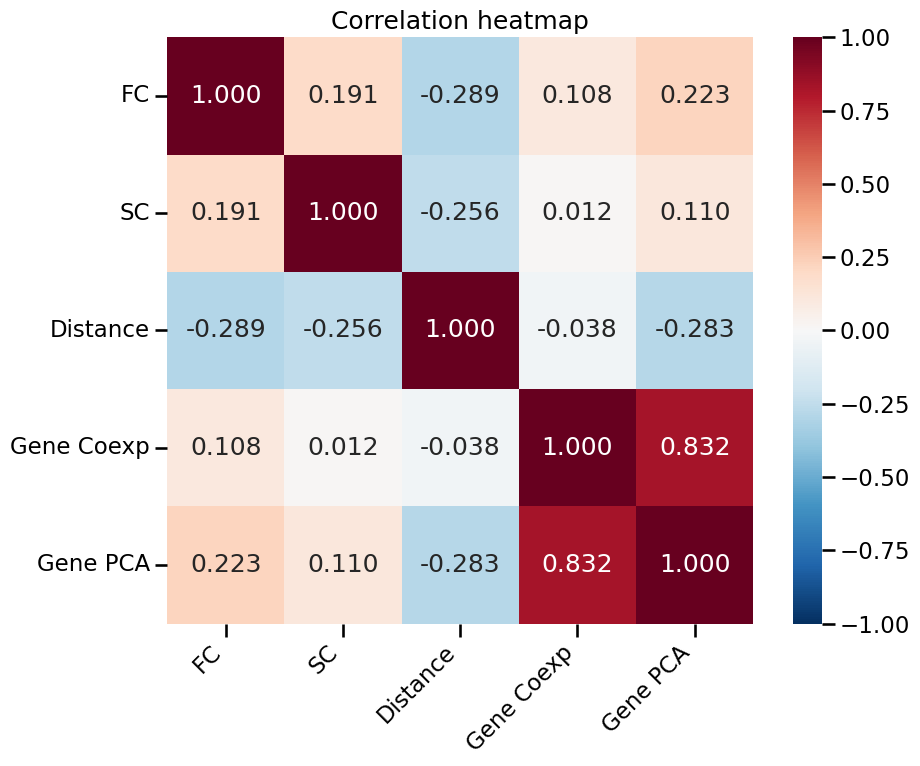


Detailed correlations:
Correlation between FC and SC: 0.191
Correlation between FC and Distance: -0.289
Correlation between FC and Gene Coexp: 0.108
Correlation between FC and Gene PCA: 0.223
Correlation between SC and Distance: -0.256
Correlation between SC and Gene Coexp: 0.012
Correlation between SC and Gene PCA: 0.110
Correlation between Distance and Gene Coexp: -0.038
Correlation between Distance and Gene PCA: -0.283
Correlation between Gene Coexp and Gene PCA: 0.832


array([[ 1.        ,  0.19147524, -0.28908999,  0.10783126,  0.22309539],
       [ 0.19147524,  1.        , -0.25553612,  0.01187714,  0.10991212],
       [-0.28908999, -0.25553612,  1.        , -0.038133  , -0.28274164],
       [ 0.10783126,  0.01187714, -0.038133  ,  1.        ,  0.83164718],
       [ 0.22309539,  0.10991212, -0.28274164,  0.83164718,  1.        ]])

In [60]:
# Call the function with default parameters
feature_names = ['fc_values', 'sc_values', 'distances', 'gene_coexpression', 'gene_PCA_coexpression']
labels = ['FC', 'SC', 'Distance', 'Gene Coexp', 'Gene PCA']

analyze_feature_correlations(features, feature_names, labels)

### Spatial Autocorrelation

In [87]:
from scipy.optimize import curve_fit
from scipy.stats import binned_statistic

def plot_spatial_autocorrelation(features, y_feature, bin_size_mm=10, figsize=(20,8), scatter_alpha=0.5, 
                                scatter_size=1, bar_alpha=0.4, errorbar_size=2,
                                label_fontsize=18, title_fontsize=20):
    """
    Plot spatial autocorrelation analysis for a given feature against distance.
    
    Parameters:
    -----------
    features : dict
        Dictionary containing 'distances' and feature arrays
    y_feature : str
        Name of feature to plot on y-axis (e.g. 'fc_values', 'sc_values', 'gene_coexpression', etc)
    bin_size_mm : float
        Size of distance bins in mm
    figsize : tuple
        Figure size as (width, height)
    scatter_alpha : float
        Alpha transparency for scatter points
    scatter_size : float
        Size of scatter points
    bar_alpha : float
        Alpha transparency for histogram bars
    errorbar_size : float
        Size of error bar points
    label_fontsize : int
        Font size for axis labels
    title_fontsize : int
        Font size for plot titles
    """
    # Define exponential decay function
    def exp_decay(x, SA_inf, SA_lambda):
        return SA_inf + (1 - SA_inf) * np.exp(-x / SA_lambda)

    # Create bins based on specified size
    bin_edges = np.arange(0, max(features['distances']) + bin_size_mm, bin_size_mm)
    
    # Calculate binned statistics
    bin_means, bin_edges, _ = binned_statistic(features['distances'], features[y_feature], 
                                             statistic='mean', bins=bin_edges)
    bin_std, _, _ = binned_statistic(features['distances'], features[y_feature], 
                                   statistic='std', bins=bin_edges)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

    # Fit SA model
    popt, _ = curve_fit(exp_decay, bin_centers, bin_means, 
                      p0=[0, 10], bounds=([-1, 0], [1, 100]), maxfev=5000)

    # Generate fit curve
    x_fit = np.linspace(min(features['distances']), max(features['distances']), 100)
    y_fit = exp_decay(x_fit, *popt)

    # Determine scatter point color based on y_feature
    color_map = {
        'fc_values': '#003366',  # Dark blue
        'sc_values': '#0066cc',  # Medium blue
        'gene_coexpression': '#3399ff',  # Light blue
        'gene_PCA_coexpression': '#66ccff'  # Very light blue
    }
    scatter_color = color_map.get(y_feature, '#6699cc')  # Default blue if feature not in map

    # Create figure
    plt.figure(figsize=figsize)
    
    # Plot feature vs Distance
    plt.bar(bin_centers, bin_means, width=bin_size_mm, color='#e6e6e6', alpha=bar_alpha)  # Light gray for histogram
    plt.scatter(features['distances'], features[y_feature], color=scatter_color, 
               alpha=scatter_alpha, s=scatter_size)
    plt.errorbar(bin_centers, bin_means, yerr=bin_std, color='black', fmt='o', 
                markersize=errorbar_size, capsize=1, linewidth=0.5, 
                label=f"Mean Correlation ({bin_size_mm}mm bins)")
    plt.plot(x_fit, y_fit, "r-", linewidth=2.5, label="Exp Decay Fit")
    plt.axvline(x=popt[1], color='green', linestyle='--', alpha=0.2)

    sa_text = f'SA-λ = {popt[1]:.3f}\nSA-∞ = {popt[0]:.3f}'
    plt.text(0.95, 0.75, sa_text, transform=plt.gca().transAxes, 
            bbox=dict(facecolor='white', alpha=0.8), 
            horizontalalignment='right', verticalalignment='bottom',
            fontsize=label_fontsize)

    plt.xlabel(f'Distance ({bin_size_mm}mm bins)', fontsize=label_fontsize)
    plt.ylabel(y_feature.replace('_', ' ').title(), fontsize=label_fontsize)
    plt.title(f'Binned Distance vs {y_feature.replace("_", " ").title()}', fontsize=title_fontsize)
    plt.tick_params(axis='both', which='major', labelsize=label_fontsize-2)
    plt.legend(fontsize=label_fontsize-2)

    plt.tight_layout()
    plt.show()
    
    return popt


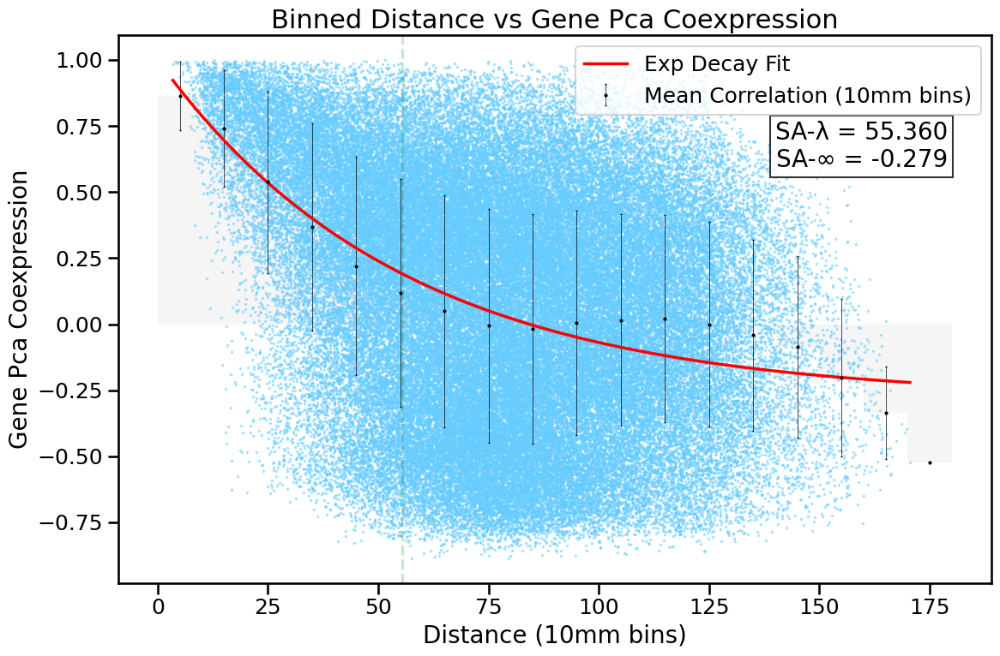

array([-0.27921742, 55.3595287 ])

In [88]:
plot_spatial_autocorrelation(features, y_feature='gene_PCA_coexpression', bin_size_mm=10, figsize=(12,8), scatter_alpha=0.5, 
                                scatter_size=1, bar_alpha=0.4, errorbar_size=2, title_fontsize=22, label_fontsize=20)

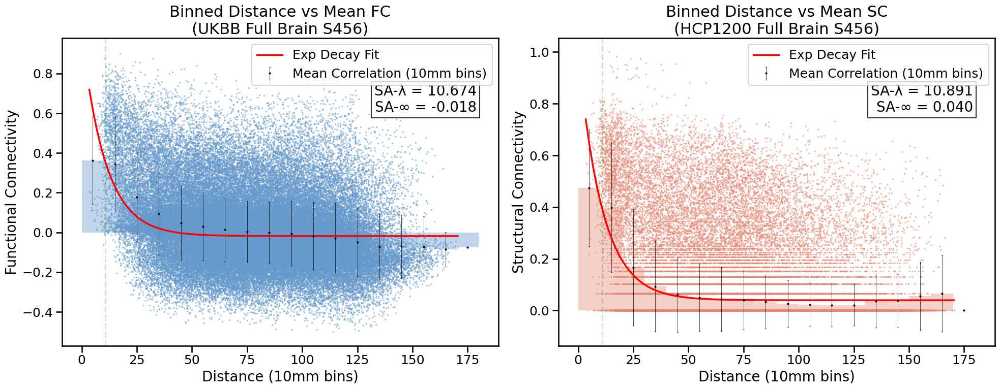

(array([-0.01824832, 10.67438062]), array([ 0.0398398 , 10.89124828]))

In [68]:
plot_spatial_autocorrelation(features, bin_size_mm=10, figsize=(20,8), scatter_alpha=0.5, 
                                scatter_size=1, bar_alpha=0.4, errorbar_size=2, title_fontsize=22, label_fontsize=20)

In [69]:
def plot_gene_spatial_autocorrelation(features, bin_size_mm=5, figsize=(20,8), scatter_alpha=0.5,
                                    scatter_size=1, bar_alpha=0.4, errorbar_size=2,
                                    label_fontsize=18, title_fontsize=20):
    """
    Plot spatial autocorrelation analysis for gene coexpression and PCA coexpression, and fit exponential decay curves.
    
    Parameters:
    -----------
    features : dict
        Dictionary containing 'distances', 'gene_coexpression', 'gene_PCA_coexpression' arrays
    bin_size_mm : float
        Size of distance bins in mm
    figsize : tuple
        Figure size as (width, height)
    scatter_alpha : float
        Alpha transparency for scatter points
    scatter_size : float
        Size of scatter points
    bar_alpha : float
        Alpha transparency for histogram bars
    errorbar_size : float
        Size of error bar points
    label_fontsize : int
        Font size for axis labels
    title_fontsize : int
        Font size for plot titles
    """
    from scipy.optimize import curve_fit
    from scipy.stats import binned_statistic

    # Define exponential decay function
    def exp_decay(x, SA_inf, SA_lambda):
        return SA_inf + (1 - SA_inf) * np.exp(-x / SA_lambda)

    # Create bins based on specified size
    bin_edges = np.arange(0, max(features['distances']) + bin_size_mm, bin_size_mm)
    
    # Calculate binned statistics for gene coexpression
    bin_means_gene, bin_edges, _ = binned_statistic(features['distances'], features['gene_coexpression'], 
                                                   statistic='mean', bins=bin_edges)
    bin_std_gene, _, _ = binned_statistic(features['distances'], features['gene_coexpression'], 
                                         statistic='std', bins=bin_edges)
    bin_centers_gene = (bin_edges[:-1] + bin_edges[1:]) / 2

    # Calculate binned statistics for PCA coexpression
    bin_means_pca, bin_edges, _ = binned_statistic(features['distances'], features['gene_PCA_coexpression'], 
                                                  statistic='mean', bins=bin_edges)
    bin_std_pca, _, _ = binned_statistic(features['distances'], features['gene_PCA_coexpression'], 
                                        statistic='std', bins=bin_edges)
    bin_centers_pca = (bin_edges[:-1] + bin_edges[1:]) / 2

    # Fit SA models
    popt_gene, _ = curve_fit(exp_decay, bin_centers_gene, bin_means_gene, 
                            p0=[0, 10], bounds=([-1, 0], [1, 100]), maxfev=5000)
    popt_pca, _ = curve_fit(exp_decay, bin_centers_pca, bin_means_pca, 
                           p0=[0, 10], bounds=([-1, 0], [1, 100]), maxfev=5000)

    # Generate fit curves
    x_fit = np.linspace(min(features['distances']), max(features['distances']), 100)
    y_fit_gene = exp_decay(x_fit, *popt_gene)
    y_fit_pca = exp_decay(x_fit, *popt_pca)

    # Create figure with two subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=figsize)

    # Plot Gene Coexpression vs Distance
    ax1.bar(bin_centers_gene, bin_means_gene, width=bin_size_mm, color='gray', alpha=bar_alpha)
    ax1.scatter(features['distances'], features['gene_coexpression'], color='#6699cc', 
                alpha=scatter_alpha, s=scatter_size)
    ax1.errorbar(bin_centers_gene, bin_means_gene, yerr=bin_std_gene, color='black', fmt='o', 
                 markersize=errorbar_size, capsize=1, linewidth=0.5, 
                 label=f"Mean Correlation ({bin_size_mm}mm bins)")
    ax1.plot(x_fit, y_fit_gene, "r-", linewidth=2.5, label="Exp Decay Fit")
    ax1.axvline(x=popt_gene[1], color='green', linestyle='--', alpha=0.2)

    sa_text = f'SA-λ = {popt_gene[1]:.3f}\nSA-∞ = {popt_gene[0]:.3f}'
    ax1.text(0.95, 0.75, sa_text, transform=ax1.transAxes, 
             bbox=dict(facecolor='white', alpha=0.8), 
             horizontalalignment='right', verticalalignment='bottom',
             fontsize=label_fontsize)

    ax1.set_xlabel(f'Distance ({bin_size_mm}mm bins)', fontsize=label_fontsize)
    ax1.set_ylabel('Gene Coexpression', fontsize=label_fontsize)
    ax1.set_title('Binned Distance vs Mean Gene Coexpression\n(AHBA Full Brain S456)', fontsize=title_fontsize)
    ax1.tick_params(axis='both', which='major', labelsize=label_fontsize-2)
    ax1.legend(fontsize=label_fontsize-2)

    # Plot PCA Coexpression vs Distance
    ax2.bar(bin_centers_pca, bin_means_pca, width=bin_size_mm, color='gray', alpha=bar_alpha)
    ax2.scatter(features['distances'], features['gene_PCA_coexpression'], color='#e68a77', 
                alpha=scatter_alpha, s=scatter_size)
    ax2.errorbar(bin_centers_pca, bin_means_pca, yerr=bin_std_pca, color='black', fmt='o',
                 markersize=errorbar_size, capsize=1, linewidth=0.5, 
                 label=f"Mean Correlation ({bin_size_mm}mm bins)")
    ax2.plot(x_fit, y_fit_pca, "r-", linewidth=2.5, label="Exp Decay Fit")
    ax2.axvline(x=popt_pca[1], color='green', linestyle='--', alpha=0.2)

    sa_text = f'SA-λ = {popt_pca[1]:.3f}\nSA-∞ = {popt_pca[0]:.3f}'
    ax2.text(0.95, 0.75, sa_text, transform=ax2.transAxes, 
             bbox=dict(facecolor='white', alpha=0.8), 
             horizontalalignment='right', verticalalignment='bottom',
             fontsize=label_fontsize)

    ax2.set_xlabel(f'Distance ({bin_size_mm}mm bins)', fontsize=label_fontsize)
    ax2.set_ylabel('Gene PCA Coexpression', fontsize=label_fontsize)
    ax2.set_title('Binned Distance vs Mean Gene PCA Coexpression\n(AHBA Full Brain S456)', fontsize=title_fontsize)
    ax2.tick_params(axis='both', which='major', labelsize=label_fontsize-2)
    ax2.legend(fontsize=label_fontsize-2)

    plt.tight_layout()
    plt.show()
    
    return popt_gene, popt_pca


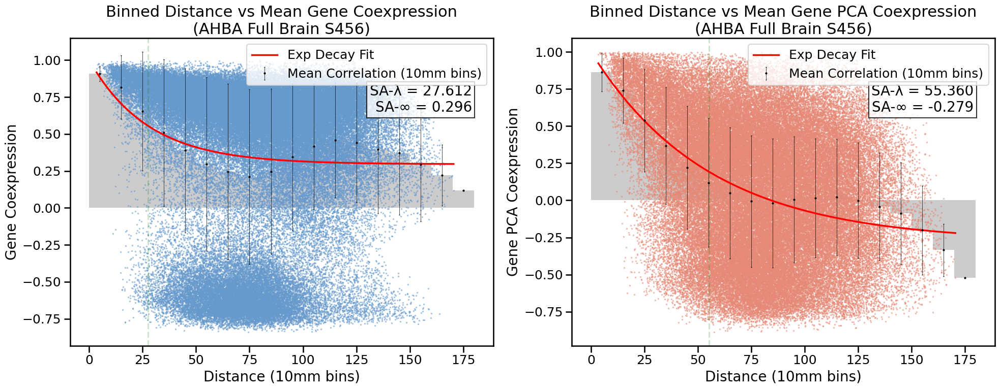

(array([ 0.29585062, 27.61164218]), array([-0.27921742, 55.3595287 ]))

In [70]:
plot_gene_spatial_autocorrelation(features, bin_size_mm=10, figsize=(20,8), scatter_alpha=0.5, 
                                scatter_size=1, bar_alpha=0.4, errorbar_size=2, title_fontsize=22, label_fontsize=20)

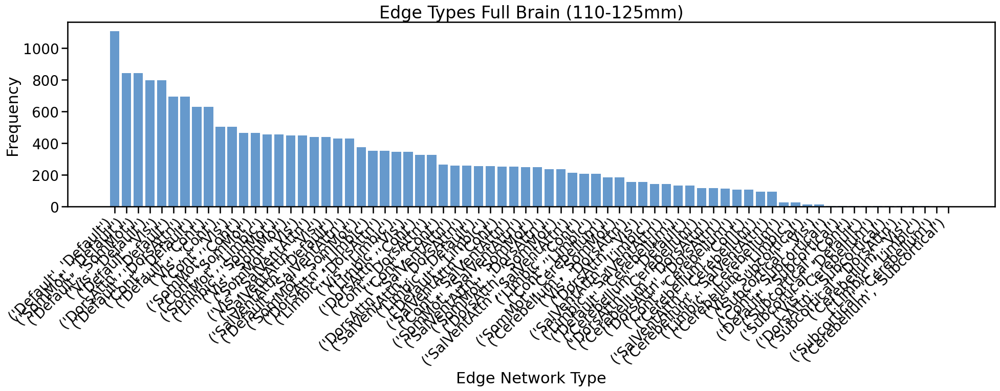

In [29]:
# Get distance range from user
lower_dist = 110
upper_dist = 125

# Create filter for distances between user-specified range
distance_filter = (features['distances'] >= lower_dist) & \
       (features['distances'] <= upper_dist)

# Get the edge networks for distances in this range
edges_in_range = [edge_networks[i] for i in range(len(features['distances'])) if distance_filter[i]]

# Count occurrences of each edge type
edge_counts = {}
for edge in edges_in_range:
    if edge in edge_counts:
        edge_counts[edge] += 1
    else:
        edge_counts[edge] = 1

# Sort by frequency
sorted_edges = sorted(edge_counts.items(), key=lambda x: x[1], reverse=True)

# Create bar plot 
plt.figure(figsize=(20, 8))
plt.bar(range(len(sorted_edges)), [count for _, count in sorted_edges], color='#6699cc')
plt.xticks(range(len(sorted_edges)), [edge for edge, _ in sorted_edges], rotation=45, ha='right')
plt.xlabel('Edge Network Type', fontsize=22)
plt.ylabel('Frequency', fontsize=22)
plt.title(f'Edge Types Full Brain ({lower_dist}-{upper_dist}mm)', fontsize=24)
plt.tick_params(axis='both', which='major', labelsize=20)
plt.tight_layout()
plt.show()


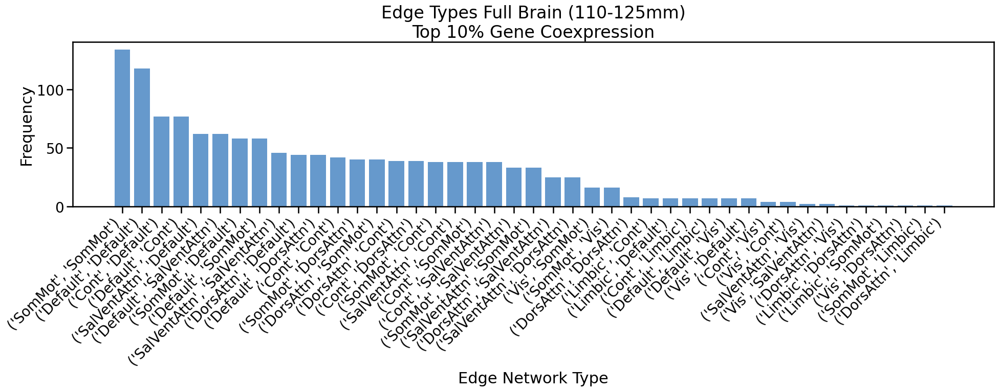

In [30]:
# Get distance range from user
lower_dist = 110
upper_dist = 125

# Calculate 90th percentile threshold for gene coexpression
coexp_threshold = np.percentile(features['gene_coexpression'], 90)

# Create filter for distances between user-specified range AND high gene coexpression
distance_coexp_filter = (features['distances'] >= lower_dist) & \
       (features['distances'] <= upper_dist) & \
       (features['gene_coexpression'] >= coexp_threshold)

# Get the edge networks for distances in this range with high coexpression
edges_in_range = [edge_networks[i] for i in range(len(features['distances'])) if distance_coexp_filter[i]]

# Count occurrences of each edge type
edge_counts = {}
for edge in edges_in_range:
    if edge in edge_counts:
        edge_counts[edge] += 1
    else:
        edge_counts[edge] = 1

# Sort by frequency
sorted_edges = sorted(edge_counts.items(), key=lambda x: x[1], reverse=True)

# Create bar plot 
plt.figure(figsize=(20, 8))
plt.bar(range(len(sorted_edges)), [count for _, count in sorted_edges], color='#6699cc')
plt.xticks(range(len(sorted_edges)), [edge for edge, _ in sorted_edges], rotation=45, ha='right')
plt.xlabel('Edge Network Type', fontsize=22)
plt.ylabel('Frequency', fontsize=22)
plt.title(f'Edge Types Full Brain ({lower_dist}-{upper_dist}mm)\nTop 10% Gene Coexpression', fontsize=24)
plt.tick_params(axis='both', which='major', labelsize=20)
plt.tight_layout()
plt.show()


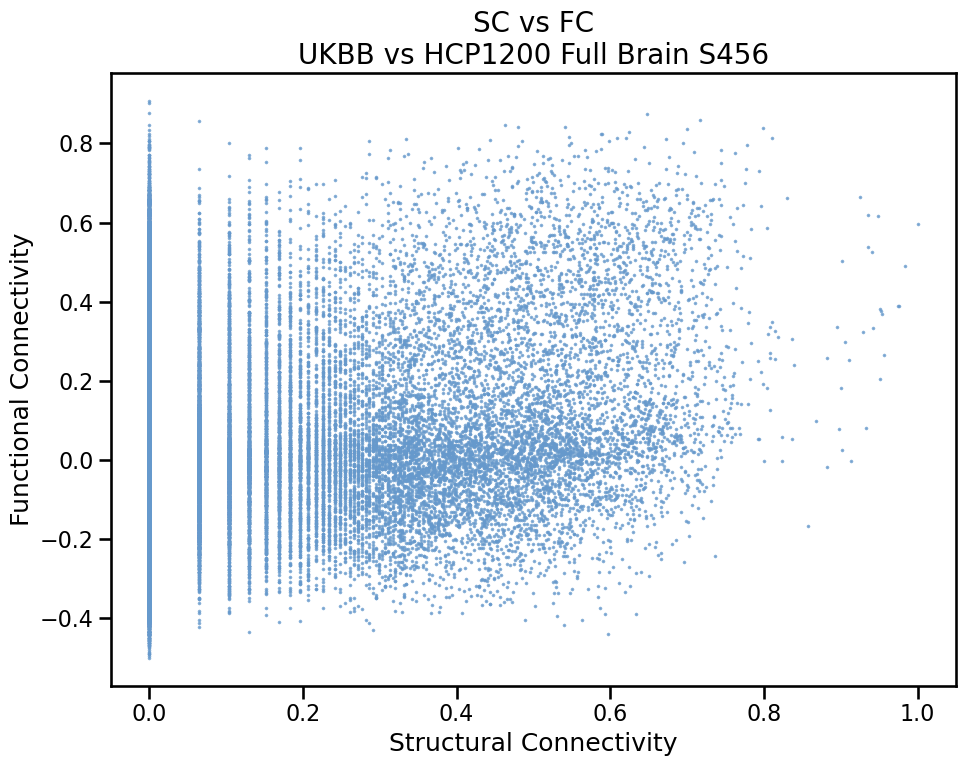

In [31]:

# --- PLOT SC vs FC ---
plt.figure(figsize=(10, 8))
plt.scatter(features['sc_values'], features['fc_values'], color='#6699cc', alpha=0.5, s=1)
plt.xlabel('Structural Connectivity', fontsize=18)
plt.ylabel('Functional Connectivity', fontsize=18)
plt.title('SC vs FC\nUKBB vs HCP1200 Full Brain S456', fontsize=20)
plt.tick_params(axis='both', which='major', labelsize=16)
plt.tight_layout()
plt.show()

Hemisphere masks

In [32]:
# Create masks for different brain regions
left_hemi_mask = np.array([label.startswith('LH_') for label in region_labels])
right_hemi_mask = np.array([label.startswith('RH_') for label in region_labels])
cortical_mask = np.array([label.startswith('LH_') or label.startswith('RH_') for label in region_labels])

# Apply masks to get filtered data
# Left hemisphere
X_left = X[left_hemi_mask]
Y_sc_left = Y_sc[left_hemi_mask][:, left_hemi_mask]
Y_fc_left = Y_fc[left_hemi_mask][:, left_hemi_mask]
network_labels_left = network_labels[left_hemi_mask]
region_labels_left = region_labels[left_hemi_mask]
mni_coords_left = mni_coords[left_hemi_mask]

# Right hemisphere 
X_right = X[right_hemi_mask]
Y_sc_right = Y_sc[right_hemi_mask][:, right_hemi_mask]
Y_fc_right = Y_fc[right_hemi_mask][:, right_hemi_mask]
network_labels_right = network_labels[right_hemi_mask]
region_labels_right = region_labels[right_hemi_mask]
mni_coords_right = mni_coords[right_hemi_mask]

# Cortical regions (both hemispheres)
X_cortical = X[cortical_mask]
Y_sc_cortical = Y_sc[cortical_mask][:, cortical_mask]
Y_fc_cortical = Y_fc[cortical_mask][:, cortical_mask]
network_labels_cortical = network_labels[cortical_mask]
region_labels_cortical = region_labels[cortical_mask]
mni_coords_cortical = mni_coords[cortical_mask]

print("Left hemisphere shapes:")
print("X:", X_left.shape)
print("Y_sc:", Y_sc_left.shape)
print("Y_fc:", Y_fc_left.shape)
print()

print("Right hemisphere shapes:")
print("X:", X_right.shape) 
print("Y_sc:", Y_sc_right.shape)
print("Y_fc:", Y_fc_right.shape)
print()

print("Cortical shapes:")
print("X:", X_cortical.shape)
print("Y_sc:", Y_sc_cortical.shape)
print("Y_fc:", Y_fc_cortical.shape)


Left hemisphere shapes:
X: (202, 7380)
Y_sc: (202, 202)
Y_fc: (202, 202)

Right hemisphere shapes:
X: (202, 7380)
Y_sc: (202, 202)
Y_fc: (202, 202)

Cortical shapes:
X: (404, 7380)
Y_sc: (404, 404)
Y_fc: (404, 404)


In [33]:
features_lh = construct_features_masked(
    X=X,
    Y_sc=Y_sc, 
    Y_fc=Y_fc,
    mni_coords=mni_coords,
    mask_from=left_hemi_mask,
    mask_to=left_hemi_mask,
    spectrals=15, 
    network_labels=network_labels
)

print("Distances shape:", features['distances'].shape)
print("SC values shape:", features['sc_values'].shape)
print("FC values shape:", features['fc_values'].shape)
print("Gene coexpression shape:", features['gene_coexpression'].shape)
print("Gene PCA coexpression shape:", features['gene_PCA_coexpression'].shape)
print("Spectral similarity shape:", features['spectral_similarity'].shape)
print("Gene PCA shape:", features['edge_PCA_embeddings'].shape)
print("Spectral embeddings shape:", features['edge_spectral_embeddings'].shape)
print("MNI coordinates shape:", features['edge_mni_coords'].shape)

edge_networks = features['edge_networks']



Distances shape: (206570,)
SC values shape: (206570,)
FC values shape: (206570,)
Gene coexpression shape: (206570,)
Gene PCA coexpression shape: (206570,)
Spectral similarity shape: (206570,)
Gene PCA shape: (206570, 910)
Spectral embeddings shape: (206570, 26)
MNI coordinates shape: (206570, 6)


In [34]:
# Run GLM with 1D features
feature_names = ['distances', 'sc_values', 'gene_coexpression', 'gene_PCA_coexpression', 'spectral_similarity']
#results, r_squared_values = fit_glm(features, feature_names, target_name='fc_values')

# Run GLM with all features
feature_names = ['distances', 'sc_values', 'gene_coexpression', 'gene_PCA_coexpression', 'spectral_similarity', 'edge_PCA_embeddings', 'edge_spectral_embeddings', 'edge_mni_coords']
#results, r_squared_values = fit_glm(features, feature_names, target_name='fc_values')

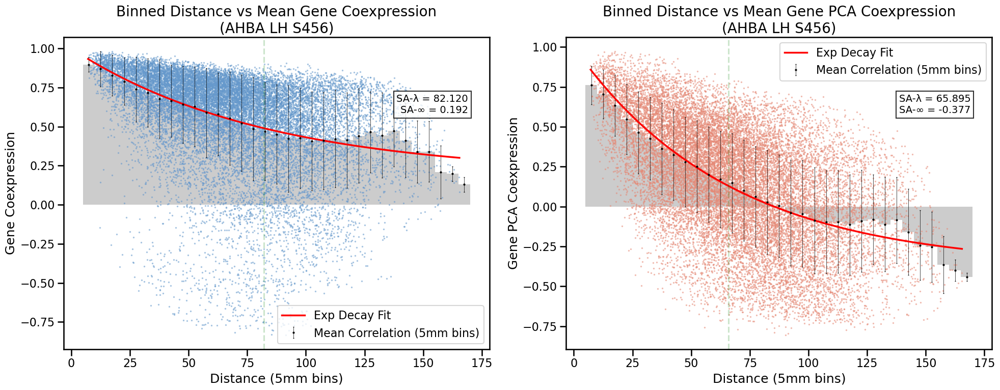

In [35]:
from scipy.optimize import curve_fit
from scipy.stats import binned_statistic
import numpy as np

# Define exponential decay function from the paper
def exp_decay(x, SA_inf, SA_lambda):
    return SA_inf + (1 - SA_inf) * np.exp(-x / SA_lambda)

# Set bin size in mm (can be adjusted)
bin_size_mm = 5  # Change this value to adjust bin size

# Create bins based on specified size
bin_edges = np.arange(0, max(features_lh['distances']) + bin_size_mm, bin_size_mm)

# Remove any NaN or inf values before binning
mask = np.isfinite(features_lh['distances']) & np.isfinite(features_lh['gene_coexpression']) & np.isfinite(features_lh['gene_PCA_coexpression'])
distances_clean = features_lh['distances'][mask]
gene_coexp_clean = features_lh['gene_coexpression'][mask]
pca_coexp_clean = features_lh['gene_PCA_coexpression'][mask]

# Calculate binned statistics with cleaned data
bin_means_gene, bin_edges, _ = binned_statistic(distances_clean, gene_coexp_clean, 
                                             statistic='mean', bins=bin_edges)
bin_std_gene, _, _ = binned_statistic(distances_clean, gene_coexp_clean, 
                                   statistic='std', bins=bin_edges)
bin_centers_gene = (bin_edges[:-1] + bin_edges[1:]) / 2

bin_means_pca, bin_edges, _ = binned_statistic(distances_clean, pca_coexp_clean, 
                                             statistic='mean', bins=bin_edges)
bin_std_pca, _, _ = binned_statistic(distances_clean, pca_coexp_clean, 
                                   statistic='std', bins=bin_edges)
bin_centers_pca = (bin_edges[:-1] + bin_edges[1:]) / 2

# Remove any NaN bins before curve fitting
gene_mask = np.isfinite(bin_means_gene) & np.isfinite(bin_centers_gene)
pca_mask = np.isfinite(bin_means_pca) & np.isfinite(bin_centers_pca)

# Fit SA model for gene coexpression
popt_gene, _ = curve_fit(exp_decay, bin_centers_gene[gene_mask], bin_means_gene[gene_mask], 
                       p0=[0, 10], bounds=([-1, 0], [1, 100]), maxfev=5000)

# Fit SA model for PCA coexpression
popt_pca, _ = curve_fit(exp_decay, bin_centers_pca[pca_mask], bin_means_pca[pca_mask], 
                       p0=[0, 10], bounds=([-1, 0], [1, 100]), maxfev=5000)

# Generate fit curve
x_fit = np.linspace(min(distances_clean), max(distances_clean), 100)
y_fit_gene = exp_decay(x_fit, *popt_gene)
y_fit_pca = exp_decay(x_fit, *popt_pca)

# Create figure with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))

# --- PLOT Gene Coexpression vs Distance ---
# Add histogram-like bars first with high transparency
ax1.bar(bin_centers_gene[gene_mask], bin_means_gene[gene_mask], width=bin_size_mm, color='gray', alpha=0.4)
# Plot scatter points
ax1.scatter(distances_clean, gene_coexp_clean, color='#6699cc', alpha=0.5, s=1)
# Plot mean points with error bars
ax1.errorbar(bin_centers_gene[gene_mask], bin_means_gene[gene_mask], yerr=bin_std_gene[gene_mask], color='black', fmt='o', 
             markersize=2, capsize=1, linewidth=0.5, label=f"Mean Correlation ({bin_size_mm}mm bins)")
ax1.plot(x_fit, y_fit_gene, "r-", linewidth=2.5, label="Exp Decay Fit")

# Add vertical line at lambda
ax1.axvline(x=popt_gene[1], color='green', linestyle='--', alpha=0.2)

# Add text box for SA parameters
sa_text = f'SA-λ = {popt_gene[1]:.3f}\nSA-∞ = {popt_gene[0]:.3f}'
ax1.text(0.95, 0.75, sa_text, transform=ax1.transAxes, 
         bbox=dict(facecolor='white', alpha=0.8), 
         horizontalalignment='right', verticalalignment='bottom',
         fontsize=14)

ax1.set_xlabel(f'Distance ({bin_size_mm}mm bins)', fontsize=18)
ax1.set_ylabel('Gene Coexpression', fontsize=18)
ax1.set_title('Binned Distance vs Mean Gene Coexpression\n(AHBA LH S456)', fontsize=20)
ax1.tick_params(axis='both', which='major', labelsize=16)
ax1.legend(fontsize=16)

# --- PLOT PCA Coexpression vs Distance ---
# Add histogram-like bars first with high transparency
ax2.bar(bin_centers_pca[pca_mask], bin_means_pca[pca_mask], width=bin_size_mm, color='gray', alpha=0.4)
# Plot scatter points
ax2.scatter(distances_clean, pca_coexp_clean, color='#e68a77', alpha=0.5, s=1)
# Plot mean points with error bars
ax2.errorbar(bin_centers_pca[pca_mask], bin_means_pca[pca_mask], yerr=bin_std_pca[pca_mask], color='black', fmt='o',
             markersize=2, capsize=1, linewidth=0.5, label=f"Mean Correlation ({bin_size_mm}mm bins)")
ax2.plot(x_fit, y_fit_pca, "r-", linewidth=2.5, label="Exp Decay Fit")

# Add vertical line at lambda
ax2.axvline(x=popt_pca[1], color='green', linestyle='--', alpha=0.2)

# Add text box for SA parameters
sa_text = f'SA-λ = {popt_pca[1]:.3f}\nSA-∞ = {popt_pca[0]:.3f}'
ax2.text(0.95, 0.75, sa_text, transform=ax2.transAxes, 
         bbox=dict(facecolor='white', alpha=0.8), 
         horizontalalignment='right', verticalalignment='bottom',
         fontsize=14)

ax2.set_xlabel(f'Distance ({bin_size_mm}mm bins)', fontsize=18)
ax2.set_ylabel('Gene PCA Coexpression', fontsize=18)
ax2.set_title('Binned Distance vs Mean Gene PCA Coexpression\n(AHBA LH S456)', fontsize=20)
ax2.tick_params(axis='both', which='major', labelsize=16)
ax2.legend(fontsize=16)

plt.tight_layout()
plt.show()


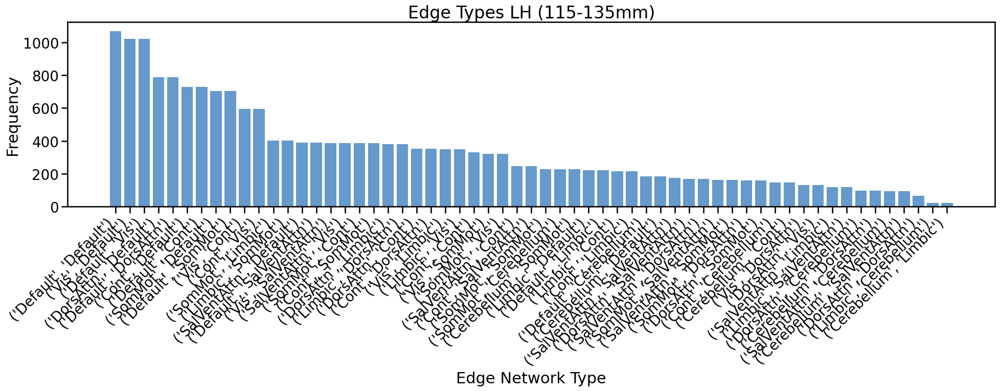

In [37]:
# Get distance range from user
lower_dist_lh = 115
upper_dist_lh = 135

# Calculate 90th percentile threshold for gene coexpression
coexp_threshold_lh = np.percentile(features['gene_coexpression'], 0)

# Create filter for distances between user-specified range AND high gene coexpression
distance_coexp_filter_lh = (features['distances'] >= lower_dist_lh) & \
       (features['distances'] <= upper_dist_lh) & \
       (features['gene_coexpression'] >= coexp_threshold_lh)

# Get the edge networks for distances in this range with high coexpression
edges_in_range_lh = [edge_networks[i] for i in range(len(features['distances'])) if distance_coexp_filter_lh[i]]

# Count occurrences of each edge type
edge_counts_lh = {}
for edge in edges_in_range_lh:
    if edge in edge_counts_lh:
        edge_counts_lh[edge] += 1
    else:
        edge_counts_lh[edge] = 1

# Sort by frequency
sorted_edges_lh = sorted(edge_counts_lh.items(), key=lambda x: x[1], reverse=True)

# Create bar plot 
plt.figure(figsize=(20, 8))
plt.bar(range(len(sorted_edges_lh)), [count for _, count in sorted_edges_lh], color='#6699cc')
plt.xticks(range(len(sorted_edges_lh)), [edge for edge, _ in sorted_edges_lh], rotation=45, ha='right')
plt.xlabel('Edge Network Type', fontsize=22)
plt.ylabel('Frequency', fontsize=22)
plt.title(f'Edge Types LH ({lower_dist_lh}-{upper_dist_lh}mm)', fontsize=24)
plt.tick_params(axis='both', which='major', labelsize=20)
plt.tight_layout()
plt.show()


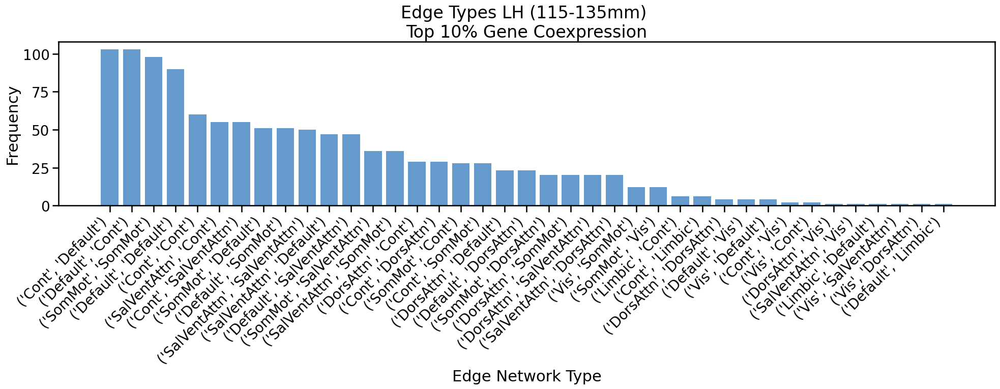

In [39]:
# Get distance range from user
lower_dist_lh = 115
upper_dist_lh = 135

# Calculate 90th percentile threshold for gene coexpression
coexp_threshold_lh = np.percentile(features['gene_coexpression'], 90)

# Create filter for distances between user-specified range AND high gene coexpression
distance_coexp_filter_lh = (features['distances'] >= lower_dist_lh) & \
       (features['distances'] <= upper_dist_lh) & \
       (features['gene_coexpression'] >= coexp_threshold_lh)

# Get the edge networks for distances in this range with high coexpression
edges_in_range_lh = [edge_networks[i] for i in range(len(features['distances'])) if distance_coexp_filter_lh[i]]

# Count occurrences of each edge type
edge_counts_lh = {}
for edge in edges_in_range_lh:
    if edge in edge_counts_lh:
        edge_counts_lh[edge] += 1
    else:
        edge_counts_lh[edge] = 1

# Sort by frequency
sorted_edges_lh = sorted(edge_counts_lh.items(), key=lambda x: x[1], reverse=True)

# Create bar plot 
plt.figure(figsize=(20, 8))
plt.bar(range(len(sorted_edges_lh)), [count for _, count in sorted_edges_lh], color='#6699cc')
plt.xticks(range(len(sorted_edges_lh)), [edge for edge, _ in sorted_edges_lh], rotation=45, ha='right')
plt.xlabel('Edge Network Type', fontsize=22)
plt.ylabel('Frequency', fontsize=22)
plt.title(f'Edge Types LH ({lower_dist_lh}-{upper_dist_lh}mm) \nTop 10% Gene Coexpression', fontsize=24)
plt.tick_params(axis='both', which='major', labelsize=20)
plt.tight_layout()
plt.show()
